# Synthetic Deformation Head and Neck Examples

In [1]:
import re
from pathlib import Path

import SimpleITK as sitk

from platipy.dicom.download.tcia import get_hn_data
from platipy.dicom.dicom_directory_crawler.conversion_utils import process_dicom_directory

from platipy.imaging.visualisation.tools import ImageVisualiser
from platipy.imaging.utils.tools import get_com
from platipy.imaging.registration.registration import apply_field

from platipy.imaging.deformation_fields.deformation_field_operations import (
    get_external_mask,
    get_bone_mask,
    generate_field_radial_bend,
    generate_field_shift,
    generate_field_asymmetric_contract,
    generate_field_asymmetric_extend,
    generate_field_expand
)

## First grab some sample data from the TCIA

In the below cell this is also converted to Nifti format

In [2]:
data = get_hn_data(number_of_patients=1)
patient_id = next(iter(data))

nifti_directory = Path("./nifti_output")
process_dicom_directory(data[patient_id], output_directory="nifti_output")


tipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 83
2021-02-09 04:42:29.105 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 84
2021-02-09 04:42:29.130 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 85
2021-02-09 04:42:29.158 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 86
2021-02-09 04:42:29.172 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 87
2021-02-09 04:42:29.183 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 88
2021-02-09 04:42:29.195 | DEBUG    | platipy.dicom.dicom_directory_crawler.conversion_utils:process_dicom_file_list:293 -   Sorting file 89
2021-02-09 04:42:29.236 | DEBUG    | platipy.dicom.dicom_dir

## Let's load the CT Image and structures

We also generate an external mask and a bone mask for use later on.

In [3]:
ct_path = next(iter(nifti_directory.glob(f"{patient_id}/IMAGES/*CT*.nii.gz")))
ct = sitk.ReadImage(str(ct_path))
structure_paths = nifti_directory.glob(f"{patient_id}/STRUCTURES/*.nii.gz")
structures = {re.findall(".*_RTSTRUCT_(.*).nii.gz", p.name)[0]: sitk.ReadImage(str(p)) for p in structure_paths}
external_mask = get_external_mask(ct, dilate=15)
bone_mask = get_bone_mask(ct)

## Before we jump in to the the synthetic deformations, here's a tip on getting more information

If you're unsure what a particular function does, you can view the docstring like in the following cell:

In [15]:
generate_field_shift?

Signature:
generate_field_shift(
    mask_image,
    vector_shift=(10, 10, 10),
    gaussian_smooth=5,
)
Docstring:
Shifts (moves) a structure defined using a binary mask.

Args:
    mask_image ([SimpleITK.Image]): The binary mask to shift.
    vector_shift (tuple, optional): The displacement vector applied to the entire binary mask.
                                    Convention: (+/-, +/-, +/-) = (sup/inf, post/ant, left/right) shift.
                                    Defined in millimetres.
                                    Defaults to (10, 10, 10).
    gaussian_smooth (int | list, optional): Scale of a Gaussian kernel used to smooth the deformation vector field. Defaults to 5.

Returns:
    [SimpleITK.Image]: The binary mask following the shift.
    [SimpleITK.DisplacementFieldTransform]: The transform representing the shift.
    [SimpleITK.Image]: The displacement vector field representing the shift.
File:      /platipy/platipy/imaging/deformation_fields/deformation_field_oper

## Now we can generate a synthetic deformation

In the cell below, one of the structures (here the Left Parotid). We define a vector shift and then apply smoothing for more realistic deformation.

Finally, the ct image is deformed using the synthetic field. We also visualise each of these in the notebook using platipy's visualisation tools.

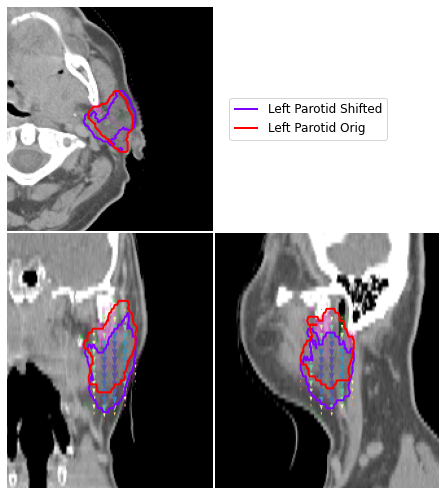

In [4]:
label_deformed, dvf_transform, dvf_field = generate_field_shift(
    structures["PAROTID_LEFT"],
    vector_shift=(-20,0,0),
    gaussian_smooth=5
)
ct_deformed = apply_field(ct, dvf_transform, structure=False, default_value=-1000)

vis = ImageVisualiser(image=ct, cut=get_com(structures["PAROTID_LEFT"]), figure_size_in=6)
vis.set_limits_from_label(label_deformed, expansion=[20, 60, 60])
vis.add_comparison_overlay(ct_deformed)
vis.add_vector_overlay(dvf_field, arrow_scale=0.25, subsample=(2,8,8), color_function="magnitude")
vis.add_contour(label_deformed, "Left Parotid Shifted")
vis.add_contour(structures["PAROTID_LEFT"], "Left Parotid Orig")
fig = vis.show()

## To apply the same synthetic deformation to all structures, you can use the following code

This uses the same apply_field function as was used to deform the CT above.

In [12]:
deformed_structures = {}
for struct in structures:
    print(f"Deforming: {struct}")
    deformed_structures[struct] = apply_field(structures[struct], dvf_transform, structure=True, default_value=0)

Deforming: BRAIN
Deforming: GTV_1
Deforming: GTV_2
Deforming: MEDULLA_OBLONGATA
Deforming: NECK_LEFT
Deforming: NECK_RIGHT
Deforming: ORAL_CAVITY
Deforming: PAROTID_LEFT
Deforming: PAROTID_RIGHT
Deforming: SPINAL_CORD
Deforming: SUBMANDIBULAR_GLAND_LEFT
Deforming: SUBMANDIBULAR_GLAND_RIGHT


## Now we'll do an expansion

Once again on the Left Parotid. The generate_field_expand function takes a structure and expands or shrinks the structure.
The variable *expand* defines the expansion (or shrinking) in mm.
It can also be defined as a 3D vector, in which case the expansion is anisotropic.

All factors positive: expansion only.


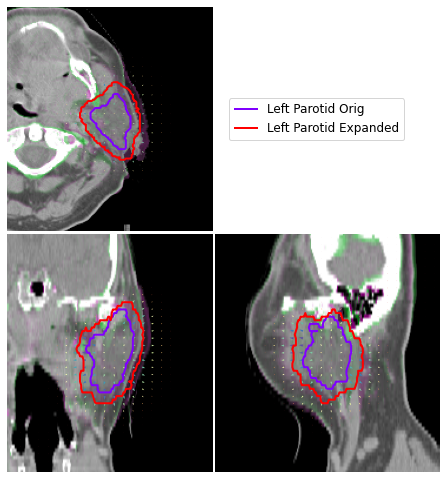

In [6]:
label_deformed, dvf_transform, dvf_field = generate_field_expand(structures["PAROTID_LEFT"], bone_mask=bone_mask, expand=10, gaussian_smooth=5)

ct_deformed = apply_field(ct, dvf_transform, structure=False, default_value=-1000)
struct_deformed = apply_field(struct, dvf_transform, structure=True, default_value=0)

vis = ImageVisualiser(image=ct, cut=get_com(structures["PAROTID_LEFT"]), figure_size_in=6)
vis.set_limits_from_label(label_deformed, expansion=[20, 60, 60])
vis.add_comparison_overlay(ct_deformed)
vis.add_vector_overlay(dvf_field, arrow_scale=0.25, subsample=(2,8,8), color_function="magnitude")
vis.add_contour(structures["PAROTID_LEFT"], "Left Parotid Orig")
vis.add_contour(label_deformed, "Left Parotid Expanded")
fig = vis.show()

## The same function can be used to expand/shrink in different directions

Mixed factors: shrinking and expansion.


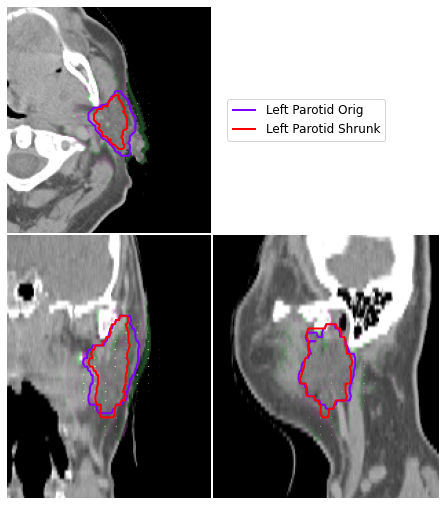

In [13]:
label_deformed, dvf_transform, dvf_field = generate_field_expand(structures["PAROTID_LEFT"], bone_mask=bone_mask, expand=[20, 0, -10], gaussian_smooth=2)

ct_deformed = apply_field(ct, dvf_transform, structure=False, default_value=-1000)

vis = ImageVisualiser(image=ct, cut=get_com(structures["PAROTID_LEFT"]), figure_size_in=6)
vis.set_limits_from_label(label_deformed, expansion=[20, 60, 60])
vis.add_comparison_overlay(ct_deformed)
vis.add_vector_overlay(dvf_field, arrow_scale=0.25, subsample=(2,8,8), color_function="magnitude")
vis.add_contour(structures["PAROTID_LEFT"], "Left Parotid Orig")
vis.add_contour(label_deformed, "Left Parotid Shrunk")
fig = vis.show()

## This next example demonstrates an asymmetric contraction

The generate_field_asymmetric_contract function takes a structure and contracts in each dimension individually (axial, coronal, sagittal).

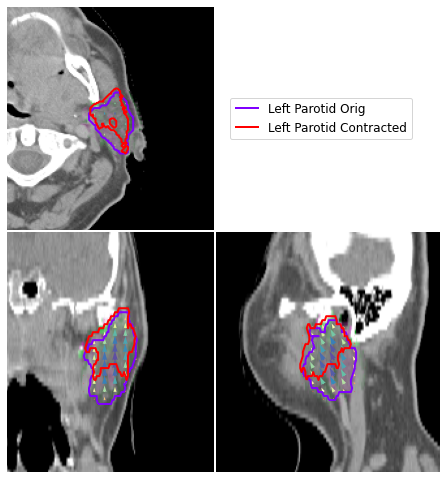

In [9]:
label_deformed, dvf_transform, dvf_field = generate_field_asymmetric_contract(
    structures["PAROTID_LEFT"],
    vector_asymmetric_contract=(-20,10,0),
    gaussian_smooth=5
)

ct_deformed = apply_field(ct, dvf_transform, structure=False, default_value=-1000)

vis = ImageVisualiser(image=ct, cut=get_com(structures["PAROTID_LEFT"]), figure_size_in=6)
vis.set_limits_from_label(label_deformed, expansion=[20, 60, 60])
vis.add_comparison_overlay(ct_deformed)
vis.add_vector_overlay(dvf_field, arrow_scale=0.25, subsample=(2,8,8), color_function="magnitude")
vis.add_contour(structures["PAROTID_LEFT"], "Left Parotid Orig")
vis.add_contour(label_deformed, "Left Parotid Contracted")
fig = vis.show()


## Similarly this example demonstrates an extension

The generate_field_asymmetric_extend function takes a structure and extends in each dimension individually (axial, coronal, sagittal).

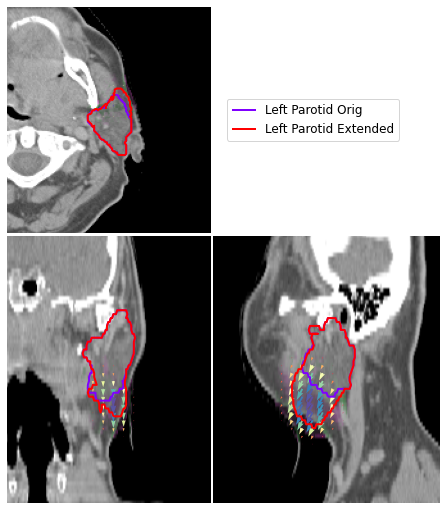

In [10]:
label_deformed, dvf_transform, dvf_field = generate_field_asymmetric_extend(
    structures["PAROTID_LEFT"],
    vector_asymmetric_extend=(-30, -15, 0),
    gaussian_smooth=5
)

ct_deformed = apply_field(ct, dvf_transform, structure=False, default_value=-1000)

vis = ImageVisualiser(image=ct, cut=get_com(structures["PAROTID_LEFT"]), figure_size_in=6)
vis.set_limits_from_label(label_deformed, expansion=[20, 60, 60])
vis.add_comparison_overlay(ct_deformed)
vis.add_vector_overlay(dvf_field, arrow_scale=0.25, subsample=(2,8,8), color_function="magnitude")
vis.add_contour(structures["PAROTID_LEFT"], "Left Parotid Orig")
vis.add_contour(label_deformed, "Left Parotid Extended")
fig = vis.show()

## In this example we generate a synthetic deformation to rotate the patient's head

In [4]:
deformed_ct, dvf_transform, dvf_field = generate_field_radial_bend(
    ct,
    external_mask,
    (70,381,255),
    axis_of_rotation=[-1, 2, 0],
    scale=0.1
)

## And visualise...

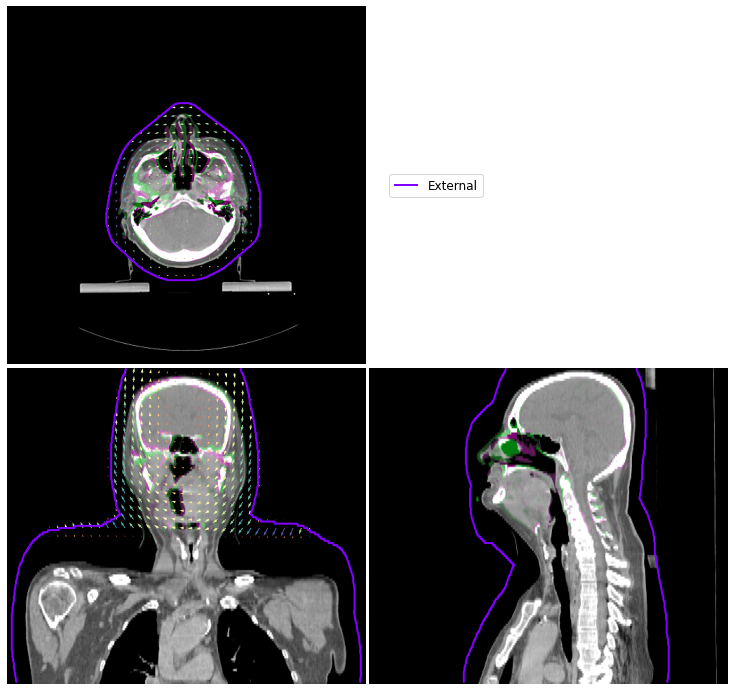

In [5]:
vis = ImageVisualiser(image=ct, cut=(104, 255, 255), figure_size_in=10)
vis.add_comparison_overlay(deformed_ct)
vis.add_vector_overlay(dvf_field, arrow_scale=1, subsample=(4,12,12), color_function="magnitude")
vis.add_contour(external_mask, "External")
fig = vis.show()

## Finally, we can save the deformed image

You can load the Nifti image in something like slicer. You can save masks in the same way. Check out the platipy documentation for information on how to convert Nifti back to DICOM.

In [ ]:
sitk.WriteImage(deformed_ct, "deformed_ct.nii.gz")